Let's try to sharpen the images or look at the surrounding area of each pixel to highlight areas that may have an issue. Then let's look at
trying to quantify the noise in each image.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pathlib
from sklearn import preprocessing, cluster, metrics


paths = pathlib.Path('./OT data 80 um/int').glob('*.tif')
paths_sorted = [x for x in paths]
paths_sorted.sort()

powderthickness = 80
objectinfo = pd.read_csv('Parameters.csv', names=["Object", "P", "S", "H", "Porosity"])
objectinfo.insert(1, "VED", objectinfo.P * 1000/(objectinfo.S * objectinfo.H * powderthickness))
ims = np.array([np.array(plt.imread(path)) for path in paths_sorted])

# Don't touch original
integrals = np.copy(ims)

In [2]:
objectwidth = 83
objectheight = 122
xspacing = 133
yspacing = 270
xstart = 293
ystart = 268
xend = 1730
yend = 1770
objectCoordinates = [[x, x+objectwidth, y, y+objectheight] for y in reversed(range(
    ystart, yend, objectheight + yspacing)) for x in range(xstart, xend, xspacing + objectwidth)]
coorddf = pd.DataFrame(objectCoordinates, columns=['xstart', 'xend', 'ystart', 'yend'])
objectinfo = coorddf.join(objectinfo)


/var/folders/q8/tcfvx04d1y11jv7mj6t996fr0000gn/T/ipykernel_79638/2145683400.py:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(12,5))


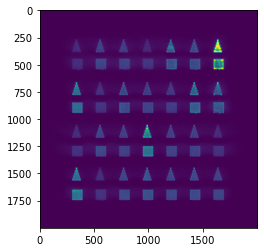

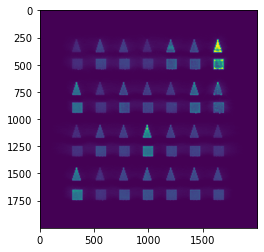

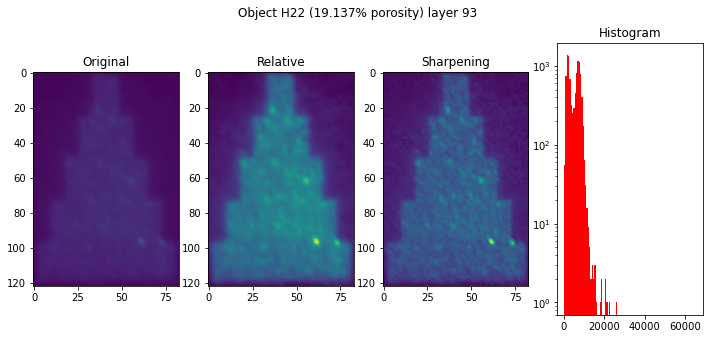

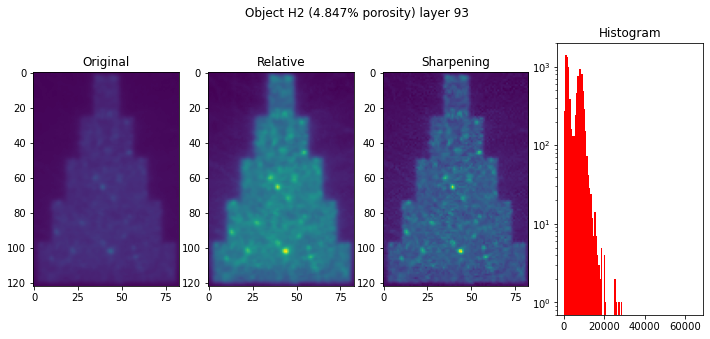

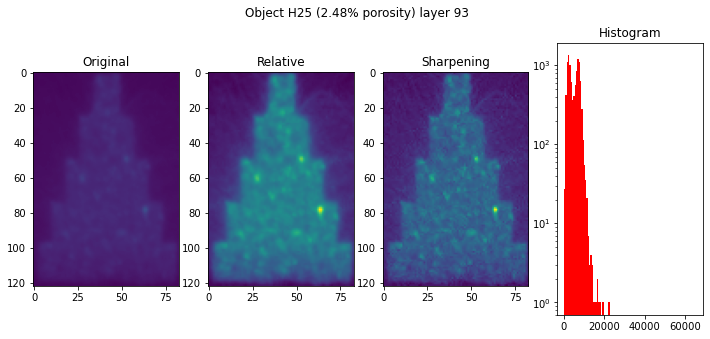

...

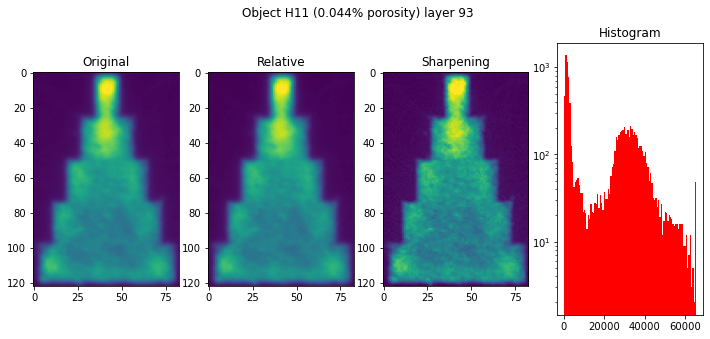

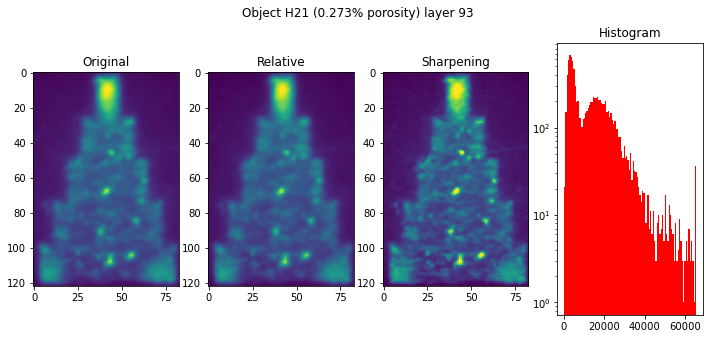

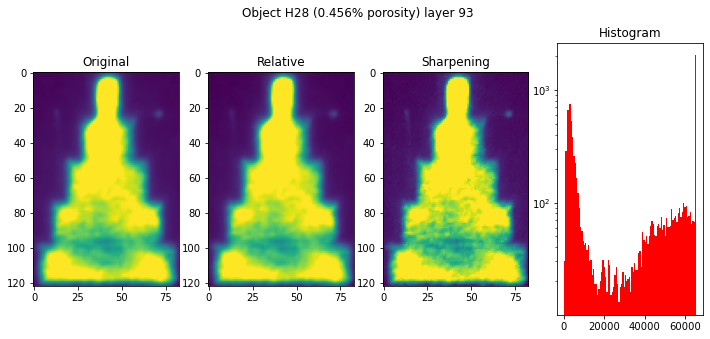

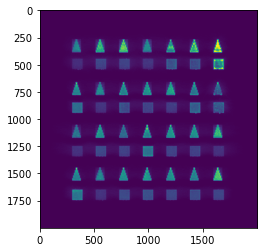

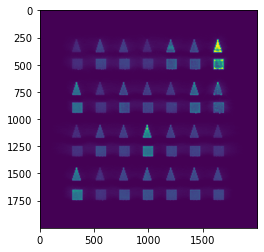

In [3]:
import cv2
# How do we implement the sharpening?
# A simple approach would be to do 2d convolution across the integrals
# A more ambitious approach would be to...

# image = integrals[93] // 2
image = np.copy(integrals[93])

kernel = np.array([[0, -1, 0],
                   [-1, 5, -1],
                   [0, -1, 0]])
image_sharp = cv2.filter2D(src=image, ddepth=-1, kernel=kernel)
plt.imshow(image_sharp)
plt.figure()
plt.imshow(integrals[93])

imageNo = 93
max_val = np.max(image_sharp)
for index, object in objectinfo.sort_values(by=['VED']).iterrows():
    img = image[object.ystart:object.yend,
                    object.xstart:object.xend]
    max_img = np.max(img)
    ratio = max_val / max_img
    image[object.ystart:object.yend,
          object.xstart:object.xend] = img * ratio
    fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(12,5))
    ax1.set_title("Original")
    ax2.set_title("Relative")
    ax3.set_title("Sharpening")
    ax4.set_title("Histogram")
    fig.suptitle("Object " + object.Object + " (" +
                    str(object.Porosity) + "% porosity) layer " + str(imageNo))
    ax1.imshow(integrals[imageNo, object.ystart:object.yend,
                object.xstart:object.xend], vmin=0, vmax=65535)
    ax2.imshow(integrals[imageNo, object.ystart:object.yend,
                object.xstart:object.xend])
    ax3.imshow(image_sharp[object.ystart:object.yend,
                        object.xstart:object.xend])
    ax4.hist(image_sharp[object.ystart:object.yend,object.xstart:object.xend].flatten(), bins=100, color='r', range=(0,65535))
    ax4.set_yscale('log')
plt.figure()
plt.imshow(image)
plt.figure()
plt.imshow(integrals[93])

Let's cluster similar to last time, bunch of different thresholds, to see what works

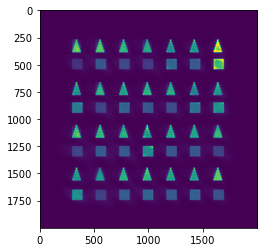

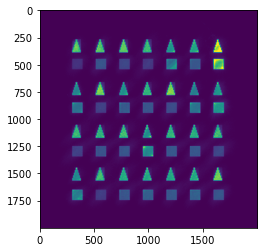

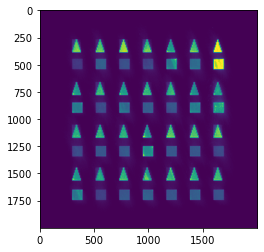

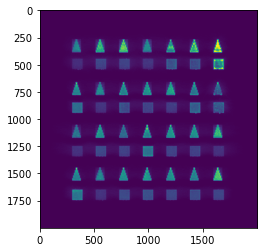

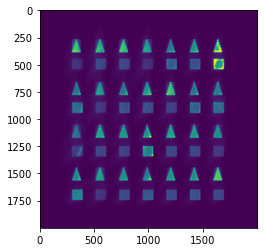

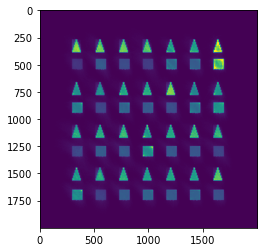

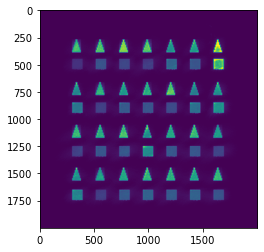

<Figure size 432x288 with 0 Axes>

In [8]:
# The prework is done here since it's time intensive

pictures = np.copy(integrals)
window_size = 4
start_layer = 93 - (window_size - 1)
end_layer = 93 + window_size
layersOfInterest = pictures[start_layer:end_layer]
# For each layer, do the normalisation thing
max_val = np.max(layersOfInterest)
for layer in layersOfInterest:
    # Todo: add sharpening
    for index, object in objectinfo.sort_values(by=['VED']).iterrows():
        img = layer[object.ystart:object.yend,
                    object.xstart:object.xend]
        max_img = np.max(img)
        ratio = max_val / max_img
        layer[object.ystart:object.yend,
            object.xstart:object.xend] = img * ratio
    plt.imshow(layer)
    plt.figure()

points = np.array([[t, x, y, value]
                  for (t, x, y), value in np.ndenumerate(layersOfInterest)])
df = pd.DataFrame(points, columns=['layer', 'x', 'y', 'value'])


/var/folders/q8/tcfvx04d1y11jv7mj6t996fr0000gn/T/ipykernel_79638/3393693852.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, noOfPlots, figsize=(60, 10))


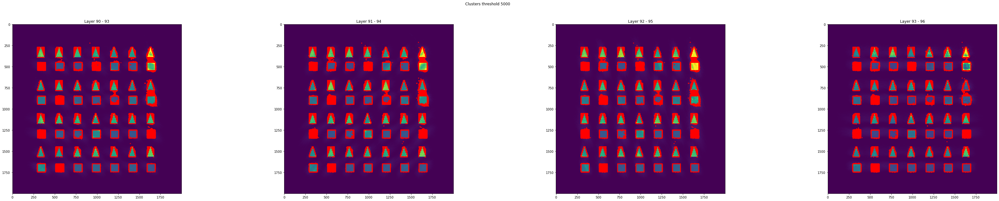

<Figure size 432x288 with 0 Axes>

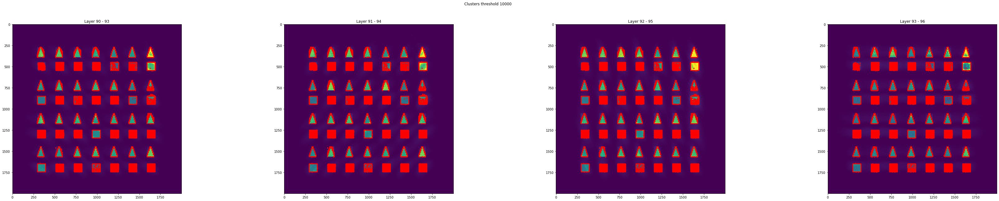

<Figure size 432x288 with 0 Axes>

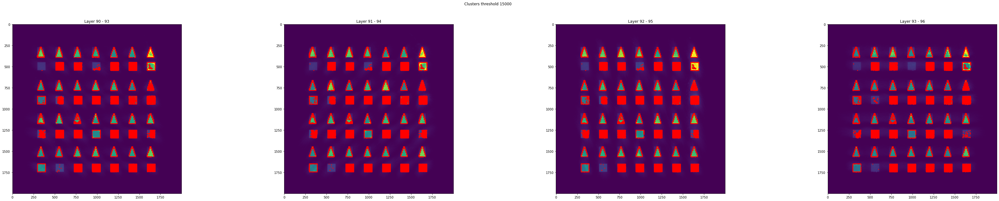

<Figure size 432x288 with 0 Axes>

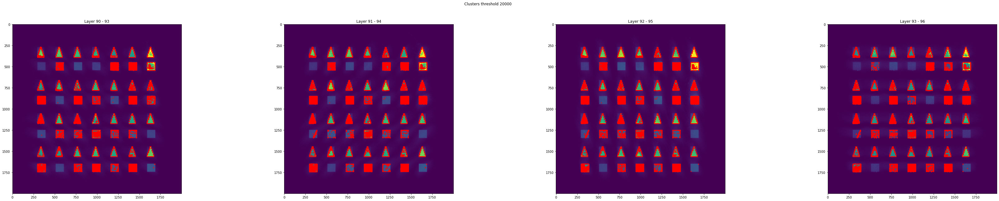

<Figure size 432x288 with 0 Axes>

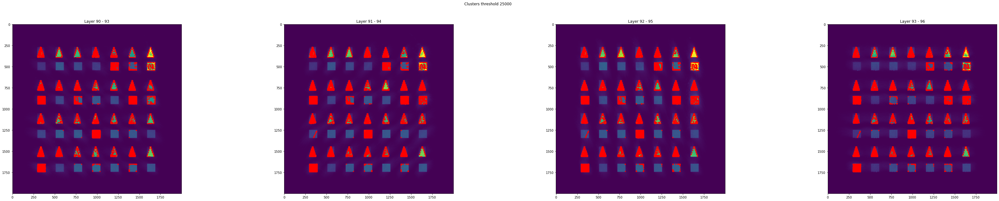

<Figure size 432x288 with 0 Axes>

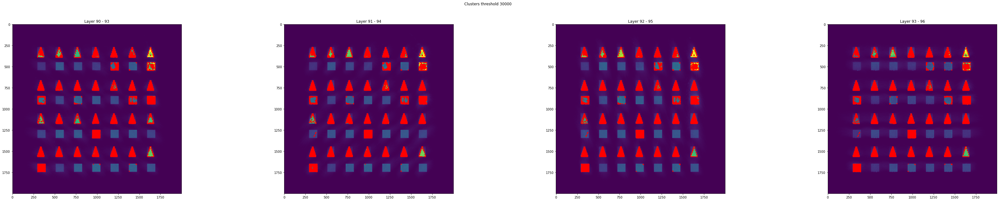

<Figure size 432x288 with 0 Axes>

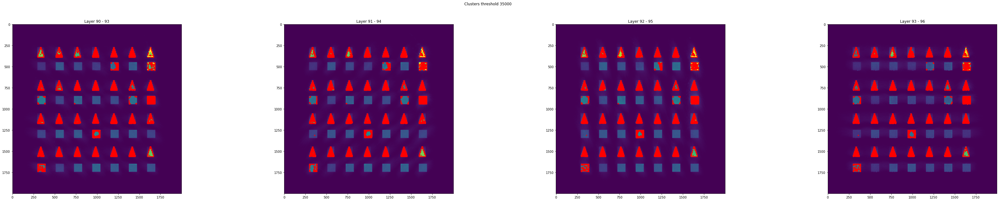

<Figure size 432x288 with 0 Axes>

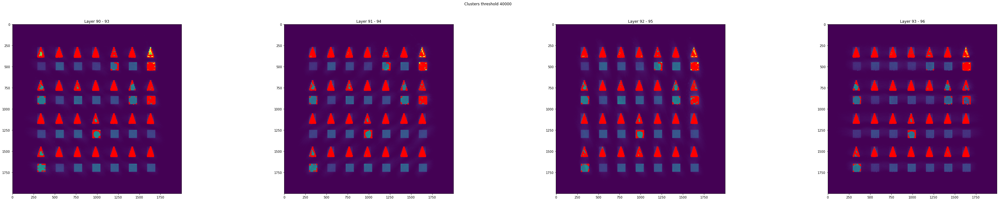

<Figure size 432x288 with 0 Axes>

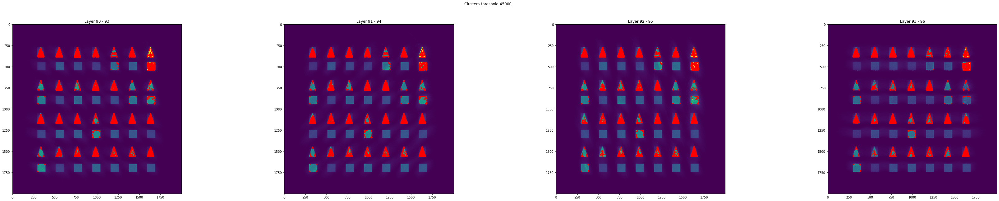

<Figure size 432x288 with 0 Axes>

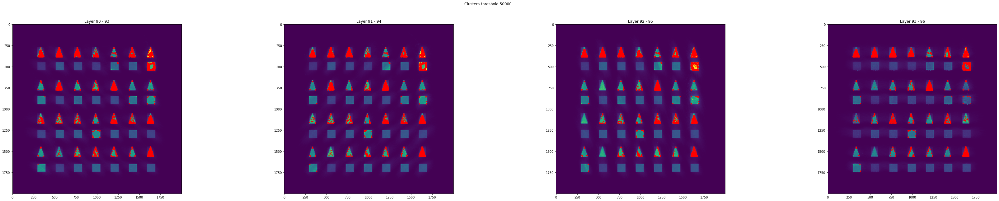

<Figure size 432x288 with 0 Axes>

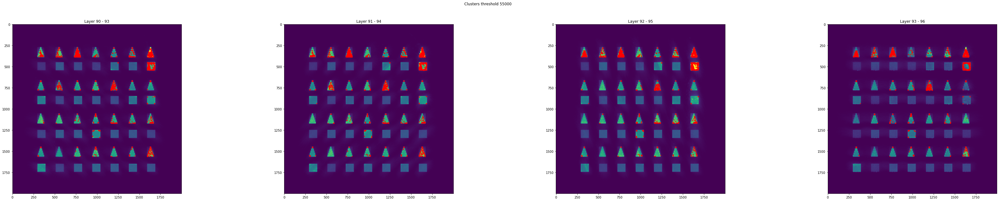

<Figure size 432x288 with 0 Axes>

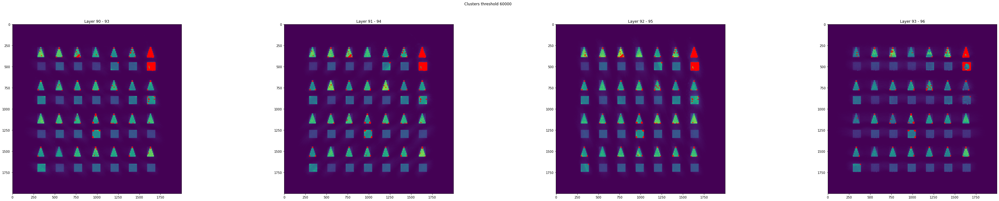

<Figure size 432x288 with 0 Axes>

In [9]:
thresholds = [(5000, 10000), (10000, 15000), (15000, 20000), (20000, 25000), (25000, 30000),
    (30000, 35000), (35000, 40000), (40000, 45000), (45000, 50000), (50000, 55000),
    (55000, 60000), (60000, 70000)]
eps = 1.5
minpts = 6
clusterings = pd.DataFrame(columns=['StartLayer', 'x', 'y', 'Cluster'])
dbscan = cluster.DBSCAN(eps=eps, min_samples=minpts, n_jobs=-1)
results = []
# Pseudocode
# For each threshold, conduct dbscan. Plot the clusters identified on the image. Ignore the noise.
# Start with a single threshold
for (mint, maxt) in thresholds:
    for i in range(0, end_layer - start_layer - window_size + 1):
        filterArray = (df.layer >= i) & (
            df.layer < i+window_size) & (df.value >= mint) & (df.value <= maxt)
        dataToCluster = df[filterArray].filter(items=['x', 'y'])
        if len(dataToCluster.index) == 0:
            continue
        result = dbscan.fit_predict(dataToCluster)
        dataToCluster.insert(loc=0, column="Cluster", value=result)
        dataToCluster.insert(loc=0, column="StartLayer", value=i + start_layer)
        dataToCluster.insert(loc=0, column="Threshold", value=mint)
        results.append(dataToCluster)
clusterings = pd.concat(results)
for (threshold, _) in thresholds:
    noOfPlots = window_size
    fig, axs = plt.subplots(1, noOfPlots, figsize=(60, 10))
    fig.suptitle("Clusters threshold " + str(threshold))
    for index, ax in enumerate(axs):
        currentStartLayer = (start_layer + end_layer) // 2 - \
            window_size + index + 1
        ax.set_title("Layer " + str(currentStartLayer) +
                     " - " + str(currentStartLayer + window_size - 1))
        pointsToShow = clusterings[(clusterings.StartLayer == currentStartLayer) & (
            clusterings.Cluster != -1) & (clusterings.Threshold == threshold)]
        ax.scatter(pointsToShow.filter(items=['y']), pointsToShow.filter(
            items=['x']), s=1, c='r')
        ax.imshow(pictures[currentStartLayer])
    plt.figure()


The last one here gives a fairly good result for identifying objects that have too low VED.

But what if we do the old approach, but first scale all areas to be close to the maximum?

Spoiler: doesn't work. 

/var/folders/q8/tcfvx04d1y11jv7mj6t996fr0000gn/T/ipykernel_79638/2417285908.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, plots, figsize=(3*plots, 5))


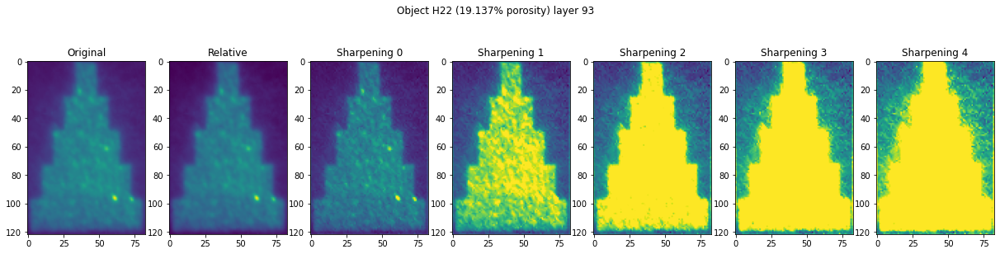

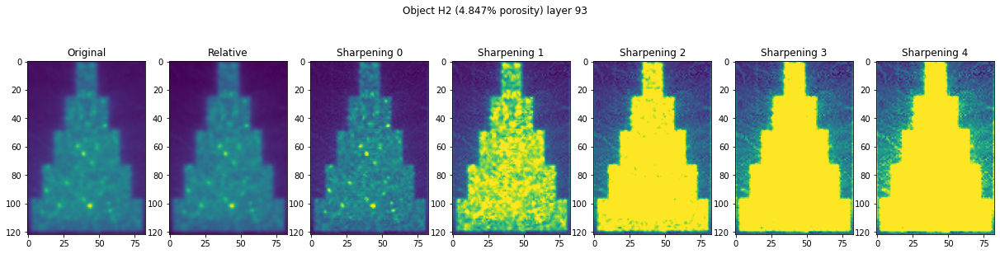

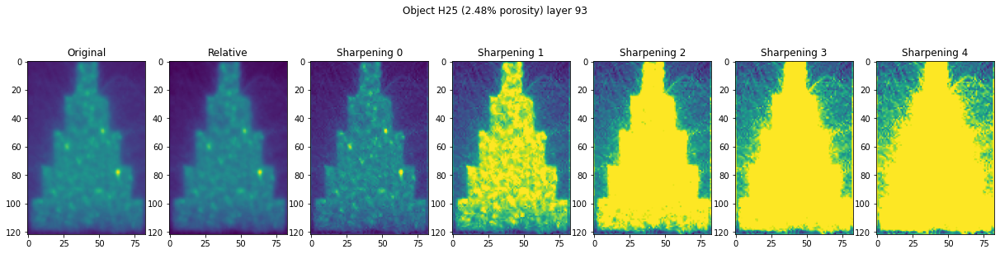

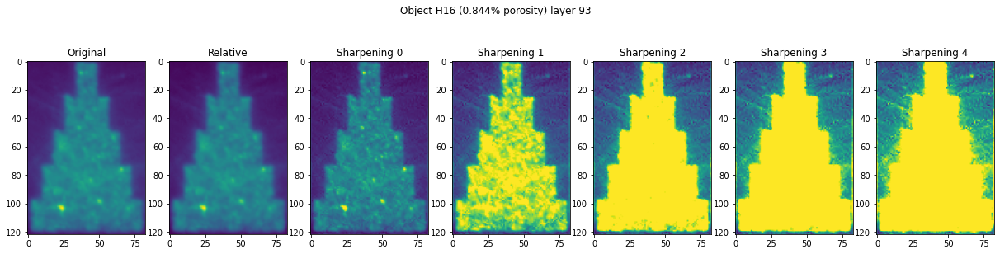

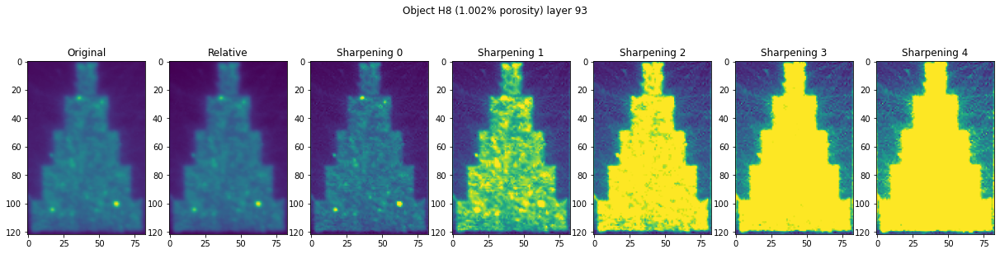

...

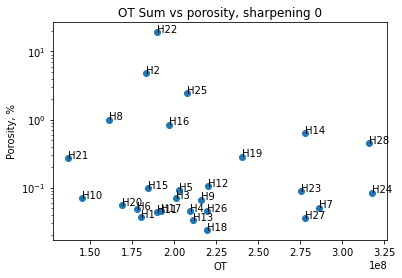

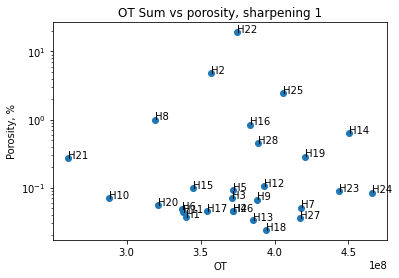

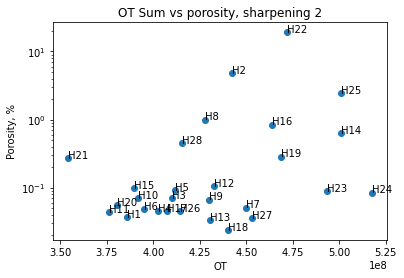

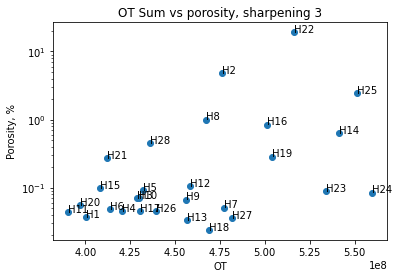

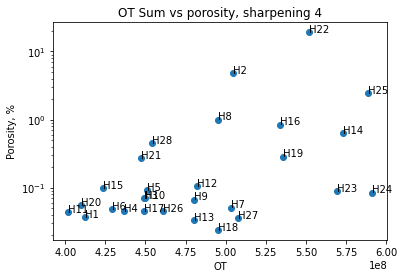

<Figure size 432x288 with 0 Axes>

In [6]:
image = np.copy(integrals[93])
for index, object in objectinfo.sort_values(by=['VED']).iterrows():
    img = image[object.ystart:object.yend,
                object.xstart:object.xend]
    max_img = np.max(img)
    ratio = max_val / max_img
    image[object.ystart:object.yend,
        object.xstart:object.xend] = img * ratio

sharpeningRange = range(1, 6)
kernels = [
    np.array([[0, -i, 0],
              [-i, i*5, -i],
              [0, -i, 0]])
    for i in sharpeningRange]
sharp_images = [cv2.filter2D(src=image, ddepth=-1, kernel=kernel)
                for kernel in kernels]

# Let's look at individual objects
imageNo = 93
for index, object in objectinfo.sort_values(by=['VED']).iterrows():
    noOfImages = len(sharp_images)
    plots = noOfImages + 2
    fig, axs = plt.subplots(1, plots, figsize=(3*plots, 5))
    fig.suptitle("Object " + object.Object + " (" +
                 str(object.Porosity) + "% porosity) layer " + str(imageNo))
    axs[0].set_title("Original")
    axs[1].set_title("Relative")
    axs[0].imshow(image[object.ystart:object.yend,
                         object.xstart:object.xend], vmin=0, vmax=65535)
    axs[1].imshow(image[object.ystart:object.yend,
                         object.xstart:object.xend])
    for index,img in enumerate(sharp_images):
        o = index+2
        axs[o].imshow(img[object.ystart:object.yend,
                            object.xstart:object.xend])
        axs[o].set_title("Sharpening " + str(index))

# Scatter plots
plt.figure()
y = objectinfo.Porosity
plt.title("OT Sum vs porosity original")
x = [np.sum(integrals[imageNo, object.ystart:object.yend, object.xstart:object.xend])
     for index, object in objectinfo.iterrows()]
plt.scatter(x, y)
for index, row in objectinfo.iterrows():
    plt.annotate(text=row.Object, xy=(x[index], y[index]))
plt.yscale('log')
plt.ylabel('Porosity, %')
plt.xlabel('OT')
plt.figure()

for index, image in enumerate(sharp_images):
    plt.title("OT Sum vs porosity, sharpening " + str(index))
    x = [np.sum(image[object.ystart:object.yend, object.xstart:object.xend])
         for index, object in objectinfo.iterrows()]
    plt.scatter(x, y)
    for index, row in objectinfo.iterrows():
        plt.annotate(text=row.Object, xy=(x[index], y[index]))
    plt.yscale('log')
    plt.ylabel('Porosity, %')
    plt.xlabel('OT')
    plt.figure()

Let's look at multiple layers instead with the clustering